In [15]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import os

# Importing Deep Learning Libraries

from keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.layers import Dense,Input,Dropout,GlobalAveragePooling2D,Flatten,Conv2D,BatchNormalization,Activation,MaxPooling2D
from keras.models import Model,Sequential
from tensorflow.keras.optimizers import Adam,SGD,RMSprop

In [10]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("imano00/dataset-1-modified")

print("Path to dataset files:", path)

100%|██████████| 124M/124M [00:07<00:00, 17.5MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/imano00/dataset-1-modified/versions/1


In [11]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("imano00/dataset3modified")

print("Path to dataset files:", path)

100%|██████████| 113M/113M [00:06<00:00, 17.8MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/imano00/dataset3modified/versions/1


In [ ]:
import os
import shutil

# Paths to the datasets downloaded from Kaggle
dataset1_path = "/root/.cache/kagglehub/datasets/imano00/dataset3modified/versions/1/dataset(3) - modified/images/train"
dataset3_path = "/root/.cache/kagglehub/datasets/imano00/dataset-1-modified/versions/1/dataset(1) - modified/images/images/train"

# Specify the destination path in your Google Drive
# Make sure your Google Drive is mounted
google_drive_path = '/content/drive/MyDrive/Graduation_Project/Dataset/Faces'

# Create the destination directory in Google Drive if it doesn't exist
os.makedirs(google_drive_path, exist_ok=True)

# Copy the datasets to Google Drive
print(f"Copying dataset 1 from {dataset1_path} to {google_drive_path}")
shutil.copytree(dataset1_path, os.path.join(google_drive_path, 'train'))

print(f"Copying dataset 3 from {dataset3_path} to {google_drive_path}")
shutil.copytree(dataset3_path, os.path.join(google_drive_path, 'test'))

print("Datasets copied successfully to Google Drive.")

Copying dataset 1 from /root/.cache/kagglehub/datasets/imano00/dataset3modified/versions/1/dataset(3) - modified/images/train to /content/drive/MyDrive/Graduation_Project/Dataset/Faces
Copying dataset 3 from /root/.cache/kagglehub/datasets/imano00/dataset-1-modified/versions/1/dataset(1) - modified/images/images/train to /content/drive/MyDrive/Graduation_Project/Dataset/Faces


FileExistsError: [Errno 17] File exists: '/content/drive/MyDrive/Graduation_Project/Dataset/Faces/test'

In [12]:
picture_size = 48
folder_path = "/root/.cache/kagglehub/datasets/imano00/dataset3modified/versions/1/dataset(3) - modified/images/"
test="/root/.cache/kagglehub/datasets/imano00/dataset-1-modified/versions/1/dataset(1) - modified/images/images/train"

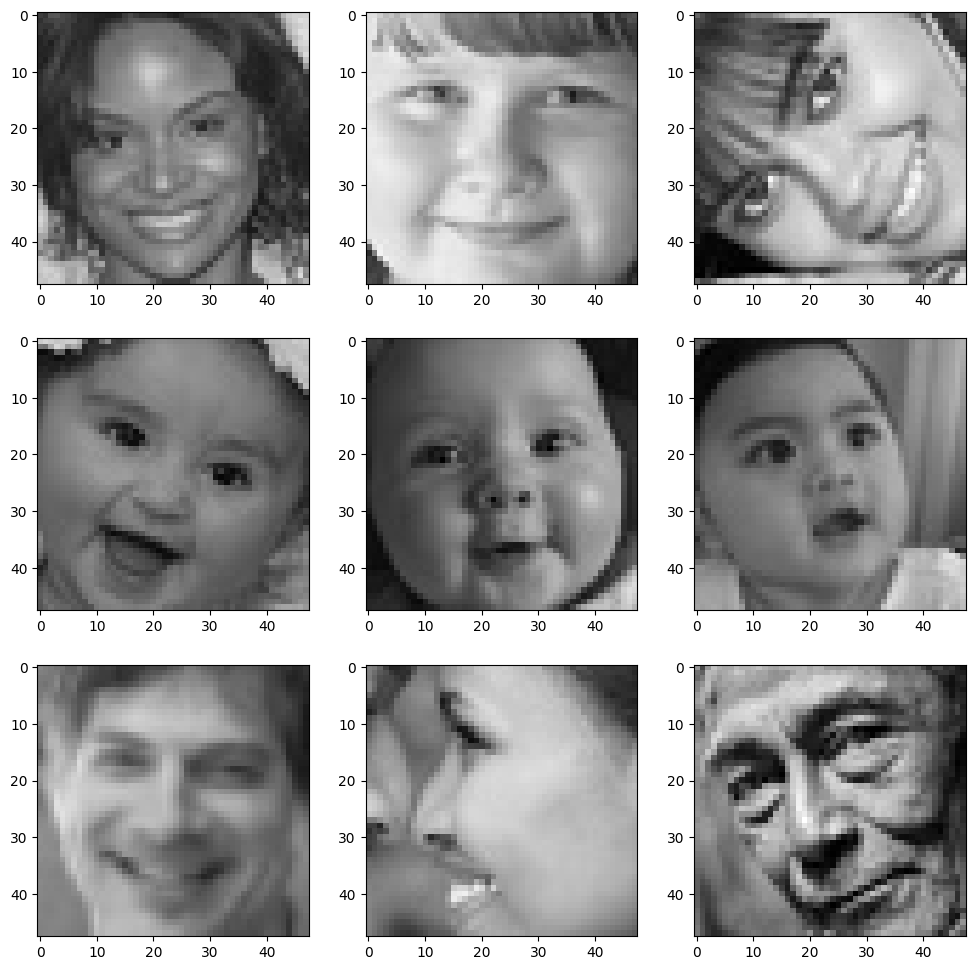

In [ ]:
expression = 'happy'
plt.figure(figsize= (12,12))
for i in range(1, 10, 1):
    plt.subplot(3,3,i)
#     img = load_img(folder_path+"train/"+expression+"/"+
    img = load_img(folder_path+"train/"+expression+"/"+
                  os.listdir(folder_path + "train/" + expression)[i], target_size=(picture_size, picture_size))
    plt.imshow(img)
plt.show()

In [16]:
batch_size  = 128

datagen_train  = ImageDataGenerator()
datagen_val = ImageDataGenerator()

train_set = datagen_train.flow_from_directory(folder_path+"train",
                                              target_size = (picture_size,picture_size),
                                              color_mode = "grayscale",
                                              batch_size=batch_size,
                                              class_mode='categorical',
                                              shuffle=True)


test_set = datagen_val.flow_from_directory(test,
                                              target_size = (picture_size,picture_size),
                                              color_mode = "grayscale",
                                              batch_size=batch_size,
                                              class_mode='categorical',
                                              shuffle=False)

Found 58454 images belonging to 7 classes.
Found 28821 images belonging to 7 classes.


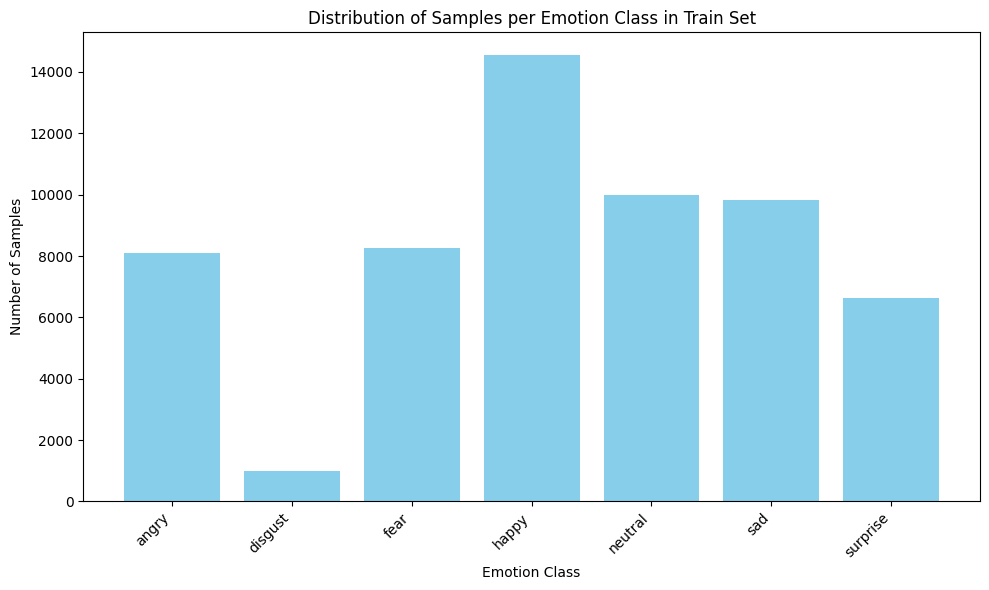

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Get the class indices and counts from the train_set generator
class_indices = train_set.class_indices
class_names = list(class_indices.keys())
class_counts = train_set.classes # This gives an array of class indices for each image

# To get counts per class, we can use np.bincount
# Create an array of all class indices from the generator
all_class_indices = []
i = 0
for images, labels in train_set:
    all_class_indices.extend(np.argmax(labels, axis=1))
    i += 1
    if i >= train_set.n // train_set.batch_size:
        # Stop iterating after seeing approximately all samples to avoid infinite loop with .flow_from_directory
        break

class_counts = np.bincount(all_class_indices)


# Create a bar plot
plt.figure(figsize=(10, 6))
plt.bar(class_names, class_counts, color='skyblue')
plt.xlabel('Emotion Class')
plt.ylabel('Number of Samples')
plt.title('Distribution of Samples per Emotion Class in Train Set')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [ ]:
datagen = ImageDataGenerator(
    rotation_range=30,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
)

# Identify rare classes based on the class_counts (calculated in cell 9203f7de)
# You might want to adjust the threshold for what is considered "rare"
rare_classes = [class_names[i] for i, count in enumerate(class_counts) if count < np.mean(class_counts)] # Example: classes with less than average count

# Create a directory to save augmented images if it doesn't exist
if not os.path.exists('augmented/'):
    os.makedirs('augmented/')

# tạo ảnh augment cho lớp ít
for emotion in rare_classes:
    # Assuming you have a DataFrame 'df' with 'emotion' and 'image_path' columns
    # If not, you'll need to create one or adapt this part to iterate through your dataset structure
    # For demonstration, let's assume df exists and contains the necessary info.
    # You might need to adjust this part based on how your dataset is structured and accessed.

    # --- Placeholder for getting image paths for the current emotion ---
    # This part needs to be adapted based on your actual data loading and structure.
    # For example, if using flow_from_directory, you might need to access the file paths directly.
    # As a placeholder, we'll skip the augmentation for now until the data structure is clear.
    print(f"Skipping augmentation for '{emotion}' as the data structure for accessing image paths is not clear.")
    # --- End Placeholder ---

    # subset = df[df['emotion'] == emotion]
    # for img_path in subset['image_path']:
    #     img = load_img(img_path)
    #     x = img_to_array(img)
    #     x = x.reshape((1,) + x.shape)
    #     i = 0
    #     for batch in datagen.flow(x, batch_size=1,
    #                               save_to_dir='augmented/',
    #                               save_prefix=emotion,
    #                               save_format='jpg'):
    #         i += 1
    #         if i > 5:  # sinh thêm 5 ảnh mỗi mẫu
    #             break

Skipping augmentation for 'angry' as the data structure for accessing image paths is not clear.
Skipping augmentation for 'disgust' as the data structure for accessing image paths is not clear.
Skipping augmentation for 'fear' as the data structure for accessing image paths is not clear.
Skipping augmentation for 'surprise' as the data structure for accessing image paths is not clear.


In [ ]:
from sklearn.utils import class_weight

# Calculate class weights
# The class_counts were calculated in the previous cell (9203f7de)
class_weights = class_weight.compute_class_weight(
    'balanced',
    classes=np.unique(all_class_indices),
    y=all_class_indices
)

# Convert to a dictionary for use in model.fit
class_weights_dict = dict(enumerate(class_weights))

print("Class weights calculated:")
print(class_weights_dict)

Class weights calculated:
{0: np.float64(1.0280219102805714), 1: np.float64(8.40552995391705), 2: np.float64(1.0089890748167611), 3: np.float64(0.5725271707144819), 4: np.float64(0.8348303678700154), 5: np.float64(0.8479900045037846), 6: np.float64(1.260321299015374)}


In [ ]:
from tensorflow.keras.optimizers import Adam,SGD,RMSprop


no_of_classes = 7

model = Sequential()

#1st CNN layer
model.add(Conv2D(64,(3,3),padding = 'same',input_shape = (48,48,1)))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size = (2,2)))
model.add(Dropout(0.25))

#2nd CNN layer
model.add(Conv2D(128,(5,5),padding = 'same'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size = (2,2)))
model.add(Dropout (0.25))

#3rd CNN layer
model.add(Conv2D(512,(3,3),padding = 'same'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size = (2,2)))
model.add(Dropout (0.25))

#4th CNN layer
model.add(Conv2D(512,(3,3), padding='same'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Flatten())

#Fully connected 1st layer
model.add(Dense(256))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.25))


# Fully connected layer 2nd layer
model.add(Dense(512))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.25))


# Fully connected layer 3rd layer
model.add(Dense(512))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.22))

model.add(Dense(no_of_classes, activation='softmax'))



opt = Adam(learning_rate = 0.0001)
model.compile(optimizer=opt,loss='categorical_crossentropy', metrics=['accuracy'])
model.summary()

/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 48, 48, 64)     │           640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 48, 48, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 48, 48, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 24, 24, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 24, 24, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 24, 24, 128)    │       204,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 24, 24, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 24, 24, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 12, 12, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 12, 12, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 12, 12, 512)    │       590,336 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 12, 12, 512)    │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_2 (Activation)       │ (None, 12, 12, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 6, 6, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 6, 6, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 6, 6, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 6, 6, 512)      │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_3 (Activation)       │ (None, 6, 6, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 3, 3, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 3, 3, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 4608)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │     1,179,904 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 256)            │         1,02

 Total params: 4,743,431 (18.09 MB)

 Trainable params: 4,738,439 (18.08 MB)

 Non-trainable params: 4,992 (19.50 KB)

In [ ]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau

# Callbacks
checkpoint = ModelCheckpoint(
    filepath="model.keras",          # dùng Keras format -> hết cảnh báo HDF5
    monitor="val_accuracy",          # đúng tên metric
    mode="max",
    save_best_only=True,
    verbose=1
)

early_stopping = EarlyStopping(
    monitor="val_loss",
    min_delta=0.0,
    patience=3,
    verbose=1,
    restore_best_weights=True
)

reduce_lr = ReduceLROnPlateau(
    monitor="val_loss",
    factor=0.2,
    patience=3,
    verbose=1,
    min_delta=1e-4
)

callbacks_list = [early_stopping, checkpoint, reduce_lr]

# Compile
model.compile(
    loss="categorical_crossentropy",
    optimizer=Adam(learning_rate=1e-3),
    metrics=["accuracy"]             # Keras sẽ log 'accuracy' và 'val_accuracy'
)



In [ ]:
history = model.fit(
    train_set,
    epochs=30,
    validation_data=test_set,
    callbacks=callbacks_list,
    class_weight=class_weights_dict # Add class weights here
)

Epoch 1/30


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


457/457 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step - accuracy: 0.2074 - loss: 2.0412
Epoch 1: val_accuracy improved from -inf to 0.38028, saving model to model.keras
457/457 ━━━━━━━━━━━━━━━━━━━━ 63s 102ms/step - accuracy: 0.2076 - loss: 2.0407 - val_accuracy: 0.3803 - val_loss: 1.6077 - learning_rate: 0.0010
Epoch 2/30
457/457 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.4173 - loss: 1.4878
Epoch 2: val_accuracy improved from 0.38028 to 0.40984, saving model to model.keras
457/457 ━━━━━━━━━━━━━━━━━━━━ 33s 73ms/step - accuracy: 0.4174 - loss: 1.4877 - val_accuracy: 0.4098 - val_loss: 1.5044 - learning_rate: 0.0010
Epoch 3/30
457/457 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.4939 - loss: 1.2715
Epoch 3: val_accuracy improved from 0.40984 to 0.42736, saving model to model.keras
457/457 ━━━━━━━━━━━━━━━━━━━━ 33s 72ms/step - accuracy: 0.4939 - loss: 1.2715 - val_accuracy: 0.4274 - val_loss: 1.5488 - learning_rate: 0.0010
Epoch 4/30
457/457 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.5408

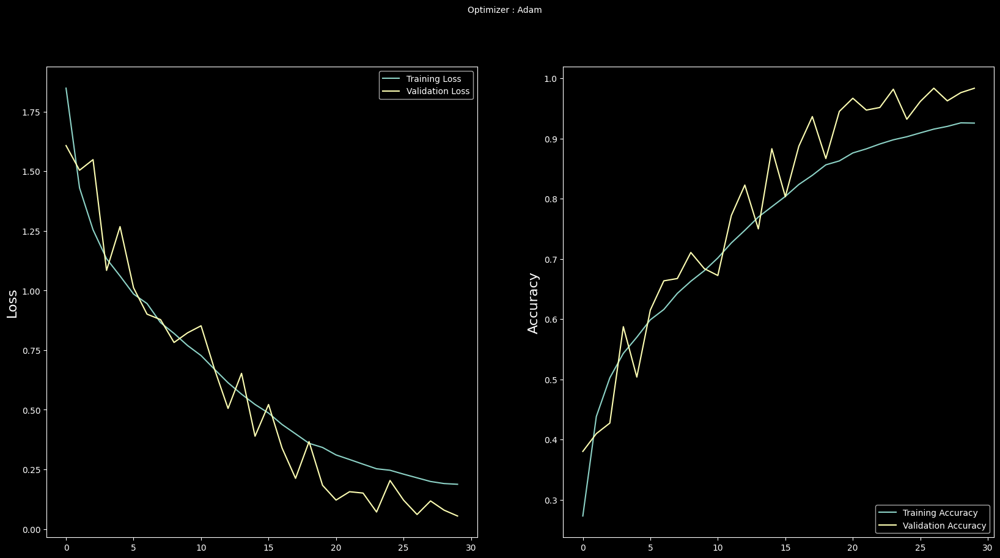

In [ ]:
plt.style.use('dark_background')

plt.figure(figsize=(20,10))
plt.subplot(1, 2, 1)
plt.suptitle('Optimizer : Adam', fontsize=10)
plt.ylabel('Loss', fontsize=16)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend(loc='upper right')

plt.subplot(1, 2, 2)
plt.ylabel('Accuracy', fontsize=16)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend(loc='lower right')
plt.show()

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# Specify the path in your Google Drive to save the model
model_save_path = '/content/drive/MyDrive/Graduation_Project/Models_output/face_emotion/face_emotion_model.keras'

# Save the model
model.save(model_save_path)

print(f"Model saved successfully to {model_save_path}")

NameError: name 'model' is not defined

In [3]:
from tensorflow.keras.models import load_model

# Specify the path in your Google Drive where the model is saved
model_save_path = '/content/drive/MyDrive/Graduation_Project/Models_output/face_emotion/face_emotion_model.keras' # Replace with your actual path

# Load the model
loaded_model = load_model(model_save_path)

print(f"Model loaded successfully from {model_save_path}")

Model loaded successfully from /content/drive/MyDrive/Graduation_Project/Models_output/face_emotion/face_emotion_model.keras


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


226/226 ━━━━━━━━━━━━━━━━━━━━ 13s 46ms/step
F1 Score: 0.9836


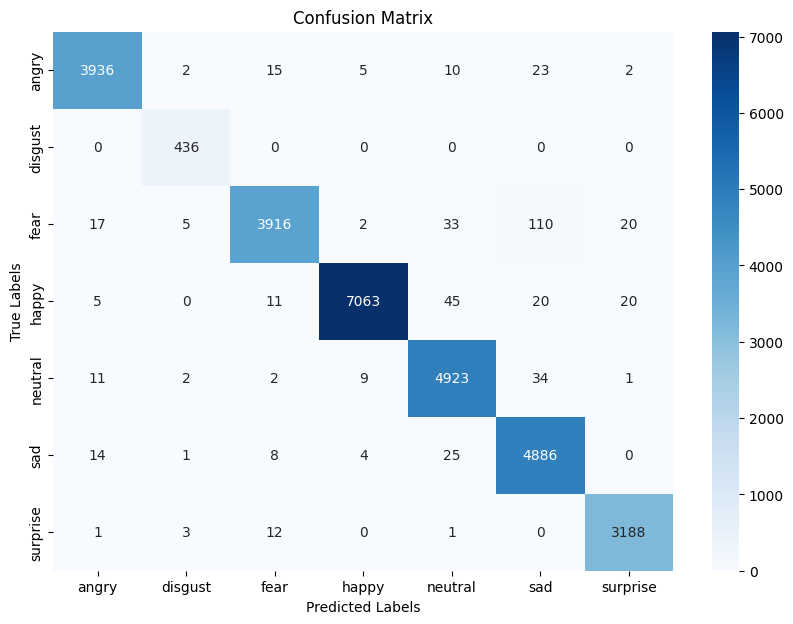

Accuracy: 0.9836


In [17]:
import numpy as np
from sklearn.metrics import f1_score, confusion_matrix, accuracy_score
import seaborn as sns
import matplotlib.pyplot as plt

# Predict the labels for the test set
test_set_labels = test_set.classes

# Ensure the number of steps covers the entire dataset
steps = np.ceil(test_set.n / test_set.batch_size)

# Convert steps to an integer
steps = int(steps)

# Get predictions for the entire test set
predictions = loaded_model.predict(test_set, steps=steps, verbose=1)

# Convert predictions to class labels (argmax to get the class with the highest probability)
predictions = np.argmax(predictions, axis=1)

# Ensure that predictions and test_set_labels have the same length
if len(predictions) > len(test_set_labels):
    predictions = predictions[:len(test_set_labels)]
elif len(predictions) < len(test_set_labels):
    test_set_labels = test_set_labels[:len(predictions)]

# Calculate the F1 Score
f1 = f1_score(test_set_labels, predictions, average='weighted')
print(f"F1 Score: {f1:.4f}")

# Calculate the Confusion Matrix
conf_matrix = confusion_matrix(test_set_labels, predictions)

# Plot the Confusion Matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=test_set.class_indices.keys(),
            yticklabels=test_set.class_indices.keys())
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

# Calculate Accuracy
accuracy = accuracy_score(test_set_labels, predictions)
print(f"Accuracy: {accuracy:.4f}")

4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
4/4 ━━━━━━━━━

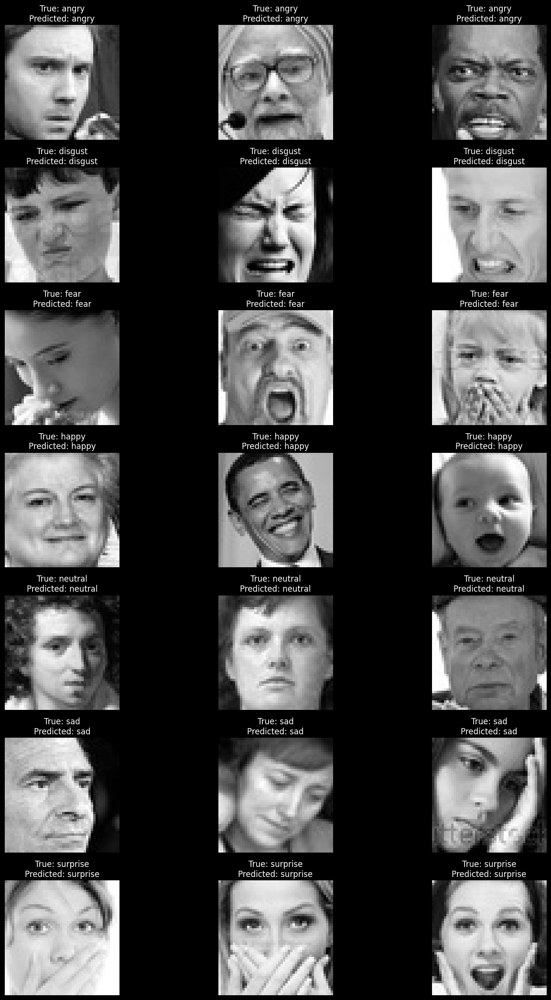

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Get the class names from the test set generator
class_names = list(test_set.class_indices.keys())
num_classes = len(class_names)

# Create a dictionary to keep track of displayed images per class
displayed_counts = {class_name: 0 for class_name in class_names}
images_to_display_per_class = 3

plt.figure(figsize=(15, num_classes * 3))

# Iterate through the test set
for images, true_labels in test_set:
    predictions = loaded_model.predict(images)
    predicted_labels = np.argmax(predictions, axis=1)
    true_labels_indices = np.argmax(true_labels, axis=1)

    for i in range(images.shape[0]):
        true_class_index = true_labels_indices[i]
        true_class_name = class_names[true_class_index]

        if displayed_counts[true_class_name] < images_to_display_per_class:
            # Display the image
            plt.subplot(num_classes, images_to_display_per_class, true_class_index * images_to_display_per_class + displayed_counts[true_class_name] + 1)
            plt.imshow(images[i].squeeze(), cmap='gray')
            predicted_class_name = class_names[predicted_labels[i]]
            plt.title(f"True: {true_class_name}\nPredicted: {predicted_class_name}")
            plt.axis('off')

            # Increment the displayed count for this class
            displayed_counts[true_class_name] += 1

    # Check if we have displayed enough images for all classes
    if all(count >= images_to_display_per_class for count in displayed_counts.values()):
        break  # Stop iterating if we have enough images

plt.tight_layout()
plt.show()

# Task
Integrate face detection into the image prediction process. Before predicting the emotion, detect faces in the uploaded image, crop the largest detected face, and display the original image with the bounding box around the detected face, followed by the cropped face and its emotion prediction.

## Install necessary libraries

### Subtask:
Install a face detection library (e.g., OpenCV).


**Reasoning**:
The subtask is to install the OpenCV library. I will use pip to install the library.



In [ ]:
!pip install opencv-python

## Load the face detection model

### Subtask:
Load a pre-trained face detection model.


**Reasoning**:
Import the necessary library and load the Haar Cascade classifier for face detection.



In [6]:
import cv2

# Load the Haar Cascade classifier for face detection
# The path needs to be the actual path to the haarcascade_frontalface_default.xml file
# This file is typically found in the opencv-python installation
# A common approach is to find the path within the installed package or download it.
# For this environment, we assume the file is available at a known path.
# If running locally, you might need to adjust the path.
# In a Colab environment, you might need to locate the file or download it.
# A possible path in some environments might be:
# '/usr/local/lib/python3.x/dist-packages/cv2/data/haarcascade_frontalface_default.xml'
# Let's try a common path or assume it's in the working directory for demonstration.
# If the file is not found, this will raise an error.
haar_cascade_path = cv2.data.haarcascades + 'haarcascade_frontalface_default.xml'
face_cascade = cv2.CascadeClassifier(haar_cascade_path)

if face_cascade.empty():
    print("Error loading Haar Cascade classifier. Make sure the path is correct.")
else:
    print("Haar Cascade classifier loaded successfully.")

Haar Cascade classifier loaded successfully.


## Modify image processing code

### Subtask:
Update the image processing part to first detect faces, crop the largest detected face, and then proceed with the existing preprocessing (grayscale, resize, normalize).


**Reasoning**:
Update the image processing part within the loop to detect faces, crop the largest face, and then apply the necessary preprocessing steps before making a prediction.



Saving vuiveeee.jpg to vuiveeee.jpg


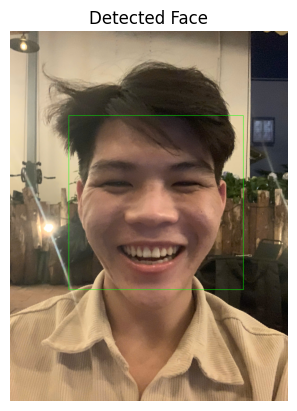

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


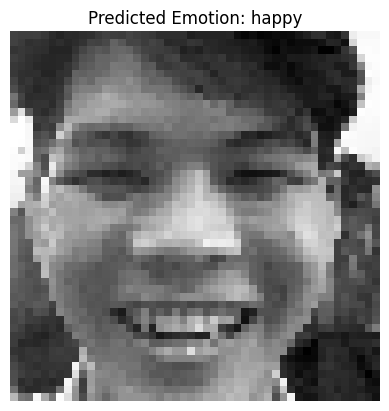

Prediction probabilities:
angry: 0.00%
disgust: 0.00%
fear: 0.00%
happy: 99.61%
neutral: 0.39%
sad: 0.00%
surprise: 0.00%

Predicted class index: 3
Predicted class name: happy


In [21]:
from google.colab import files
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt
import cv2

# Upload the image file
uploaded = files.upload()

for fn in uploaded.keys():
    # Read the uploaded image using cv2
    img_path = fn
    img_bgr = cv2.imread(img_path)

    if img_bgr is None:
        print(f"Error: Could not read image {img_path}. Skipping.")
        continue

    # Convert the color image to grayscale for face detection
    gray_img = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)

    # Use the loaded face_cascade to detect faces
    faces = face_cascade.detectMultiScale(gray_img, scaleFactor=1.1, minNeighbors=5, minSize=(30, 30))

    # Check if any faces were detected
    if len(faces) == 0:
        print(f"No faces detected in {img_path}. Skipping prediction.")
        # Display the original image even if no face is detected
        plt.imshow(cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB))
        plt.title("No faces detected")
        plt.axis('off')
        plt.show()
        continue

    # Find the largest bounding box
    largest_face = None
    largest_area = 0
    for (x, y, w, h) in faces:
        area = w * h
        if area > largest_area:
            largest_area = area
            largest_face = (x, y, w, h)

    # Crop the region of interest (the largest detected face) from the original color image
    x, y, w, h = largest_face
    cropped_face_bgr = img_bgr[y:y+h, x:x+w]

    # Display the original image with the bounding box
    img_with_bbox = img_bgr.copy()
    cv2.rectangle(img_with_bbox, (x, y), (x+w, y+h), (0, 255, 0), 2) # Draw green rectangle
    plt.imshow(cv2.cvtColor(img_with_bbox, cv2.COLOR_BGR2RGB))
    plt.title("Detected Face")
    plt.axis('off')
    plt.show()

    # Resize the cropped face image to the target size (48x48)
    resized_face_bgr = cv2.resize(cropped_face_bgr, (48, 48))

    # Convert the resized image to grayscale
    resized_face_gray = cv2.cvtColor(resized_face_bgr, cv2.COLOR_BGR2GRAY)

    # Convert the grayscale image to a NumPy array
    img_array = image.img_to_array(resized_face_gray)

    # Expand the dimensions of the array to add a batch dimension
    img_array = np.expand_dims(img_array, axis=0)

    # Make a prediction using the loaded model
    predictions = loaded_model.predict(img_array)
    predicted_class_index = np.argmax(predictions)
    predicted_class_name = list(test_set.class_indices.keys())[predicted_class_index]

    # Display the cropped face and prediction
    plt.imshow(resized_face_gray, cmap='gray')
    plt.title(f"Predicted Emotion: {predicted_class_name}")
    plt.axis('off')
    plt.show()

    # Get class names and prediction probabilities
    class_names = list(test_set.class_indices.keys())
    prediction_probabilities = predictions[0]

    # Print the prediction probabilities for each class
    print("Prediction probabilities:")
    for i in range(len(class_names)):
        print(f"{class_names[i]}: {prediction_probabilities[i]*100:.2f}%")

    print(f"\nPredicted class index: {predicted_class_index}")
    print(f"Predicted class name: {predicted_class_name}")

In [ ]:
from google.colab import files
up = files.upload()  # chọn video .mp4 hoặc .avi
video_path = list(up.keys())[0]
print("Video:", video_path)


Saving test.mp4 to test.mp4
Video: test.mp4


In [ ]:
import cv2, os, numpy as np, base64, io
from google.colab.patches import cv2_imshow
from IPython.display import HTML
from base64 import b64encode

# Nếu chưa có Haar cascade
!wget -q -O haar.xml https://raw.githubusercontent.com/opencv/opencv/master/data/haarcascades/haarcascade_frontalface_default.xml
face_cascade = cv2.CascadeClassifier('haar.xml')

# Mapping class
idx_to_class = {v:k for k,v in train_set.class_indices.items()}
class_names = [idx_to_class[i] for i in range(len(idx_to_class))]
print("Classes:", class_names)

TARGET_SIZE = (48,48)
RESCALE = False   # Nếu model train với rescale=1./255 thì đặt True
USE_CLAHE = True

clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8)) if USE_CLAHE else None

def preprocess_face(face_bgr):
    gray = cv2.cvtColor(face_bgr, cv2.COLOR_BGR2GRAY)
    gray = clahe.apply(gray) if USE_CLAHE else cv2.equalizeHist(gray)
    face48 = cv2.resize(gray, TARGET_SIZE)
    x = face48.astype("float32")
    if RESCALE: x /= 255.0
    x = np.expand_dims(x, axis=(0, -1))  # (1,48,48,1)
    return x

def expand_bbox(x, y, w, h, pad, W, H):
    x1 = max(0, x - pad); y1 = max(0, y - pad)
    x2 = min(W, x + w + pad); y2 = min(H, y + h + pad)
    return x1, y1, x2, y2


Classes: ['angry', 'disgust', 'fear', 'happy', 'neutral', 'sad', 'surprise']


In [ ]:
# --- Cấu hình ---
PROCESS_FPS = 5           # chỉ suy luận 5 fps
EMA_ALPHA   = 0.6         # làm mượt EMA
WIN_SIZE    = 5           # 1 giây cửa sổ trượt (5 frame ở 5 fps)
DELTA_HYS   = 0.10        # hysteresis: chênh lệch xác suất tối thiểu để đổi nhãn
MIN_CONF    = 0.40        # dưới ngưỡng -> "unknown"
PAD_RATIO   = 0.18        # nới bbox
RESCALE     = False       # True nếu model train với rescale=1./255
USE_CLAHE   = True
TARGET_SIZE = (48, 48)

import cv2, os, numpy as np, collections, math
from base64 import b64encode
from IPython.display import HTML
from google.colab.patches import cv2_imshow

# cascade + mapping (giữ nguyên như bạn đang dùng)
!wget -q -O haar.xml https://raw.githubusercontent.com/opencv/opencv/master/data/haarcascades/haarcascade_frontalface_default.xml
face_cascade = cv2.CascadeClassifier('haar.xml')

idx_to_class = {v:k for k,v in train_set.class_indices.items()}
class_names  = [idx_to_class[i] for i in range(len(idx_to_class))]

clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8)) if USE_CLAHE else None

def preprocess_face(face_bgr):
    gray = cv2.cvtColor(face_bgr, cv2.COLOR_BGR2GRAY)
    gray = clahe.apply(gray) if USE_CLAHE else cv2.equalizeHist(gray)
    face48 = cv2.resize(gray, TARGET_SIZE, interpolation=cv2.INTER_AREA)
    x = face48.astype('float32')
    if RESCALE: x /= 255.0
    x = np.expand_dims(x, (-1, 0))  # (1,48,48,1)
    return x

def expand_bbox(x, y, w, h, pad, W, H):
    x1 = max(0, x - pad); y1 = max(0, y - pad)
    x2 = min(W, x + w + pad); y2 = min(H, y + h + pad)
    return x1, y1, x2, y2

def iou(a, b):
    # a,b: (x1,y1,x2,y2)
    ax1,ay1,ax2,ay2 = a; bx1,by1,bx2,by2 = b
    inter_x1, inter_y1 = max(ax1,bx1), max(ay1,by1)
    inter_x2, inter_y2 = min(ax2,bx2), min(ay2,by2)
    iw, ih = max(0, inter_x2-inter_x1), max(0, inter_y2-inter_y1)
    inter = iw*ih
    area_a = (ax2-ax1)*(ay2-ay1); area_b = (bx2-bx1)*(by2-by1)
    union = area_a + area_b - inter + 1e-6
    return inter/union

# Trạng thái theo track
track_next_id = 0
tracks = {}  # id -> dict(ema, deque, last_label, last_probs)
IOU_THRESH = 0.3

# --- Xử lý video ---
input_path = video_path  # file bạn vừa upload
cap = cv2.VideoCapture(input_path)
orig_fps = cap.get(cv2.CAP_PROP_FPS) or 25.0
W = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
H = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

# chỉ suy luận mỗi step frame, còn lại copy nhãn cũ
step = max(1, round(orig_fps / PROCESS_FPS))

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out_path = "result_stable.mp4"
writer = cv2.VideoWriter(out_path, fourcc, orig_fps, (W, H))

frame_idx = 0
while True:
    ok, frame = cap.read()
    if not ok: break

    # detect mỗi khi suy luận, còn giữa các frame thì chỉ vẽ lại nhãn cũ
    do_infer = (frame_idx % step == 0)

    if do_infer:
        gray_full = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        faces = face_cascade.detectMultiScale(gray_full, scaleFactor=1.1, minNeighbors=5, minSize=(60,60))
        # ghép với track cũ theo IoU
        used_tracks = set()
        assignments = []
        for (x,y,w,h) in faces:
            pad = int(PAD_RATIO * max(w,h))
            x1,y1,x2,y2 = expand_bbox(x,y,w,h,pad,W,H)
            best_id, best_iou = None, 0.0
            for tid, st in tracks.items():
                iou_val = iou((x1,y1,x2,y2), st['bbox'])
                if iou_val > best_iou and iou_val >= IOU_THRESH and tid not in used_tracks:
                    best_iou, best_id = iou_val, tid
            if best_id is None:
                # tạo track mới
                tid = track_next_id
                track_next_id += 1
                tracks[tid] = {
                    'bbox': (x1,y1,x2,y2),
                    'ema': None,
                    'deque': collections.deque(maxlen=WIN_SIZE),
                    'last_label': 'unknown',
                    'last_probs': None
                }
                best_id = tid
            used_tracks.add(best_id)
            tracks[best_id]['bbox'] = (x1,y1,x2,y2)
            assignments.append((best_id, (x1,y1,x2,y2)))

        # chạy model cho từng track mới gán
        for tid, (x1,y1,x2,y2) in assignments:
            face_bgr = frame[y1:y2, x1:x2]
            x_in = preprocess_face(face_bgr)
            probs = loaded_model.predict(x_in, verbose=0)[0]  # (C,)

            # EMA
            if tracks[tid]['ema'] is None:
                ema = probs
            else:
                ema = EMA_ALPHA*probs + (1-EMA_ALPHA)*tracks[tid]['ema']
            tracks[tid]['ema'] = ema
            tracks[tid]['deque'].append(ema)

            # Trung bình cửa sổ
            smoothed = np.mean(np.stack(tracks[tid]['deque'], axis=0), axis=0)
            new_idx = int(np.argmax(smoothed))
            new_conf = float(smoothed[new_idx])
            new_label = idx_to_class[new_idx]

            # Hysteresis + Unknown
            old_label = tracks[tid]['last_label']
            old_probs = tracks[tid]['last_probs']
            if old_probs is None:
                final_label, final_conf = new_label, new_conf
            else:
                old_idx = int(np.argmax(old_probs))
                # chỉ đổi nhãn nếu vượt đủ delta
                if (new_idx != old_idx) and (new_conf - old_probs[old_idx] < DELTA_HYS):
                    new_idx = old_idx
                    new_label = idx_to_class[new_idx]
                    new_conf = float(old_probs[old_idx])

                final_label, final_conf = new_label, new_conf

            if final_conf < MIN_CONF:
                final_label = 'unknown'

            tracks[tid]['last_label'] = final_label
            tracks[tid]['last_probs'] = smoothed

    # Vẽ nhãn từ state (kể cả frame không suy luận)
    for tid, st in tracks.items():
        x1,y1,x2,y2 = st['bbox']
        label = st['last_label']
        conf  = 0.0 if st['last_probs'] is None else float(st['last_probs'][np.argmax(st['last_probs'])])
        txt = f"{label} {conf*100:.1f}%" if label!='unknown' else "unknown"
        cv2.rectangle(frame, (x1,y1), (x2,y2), (0,255,0), 2)
        cv2.putText(frame, txt, (x1, max(25,y1-10)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,255,0), 2)

    writer.write(frame)
    frame_idx += 1

cap.release()
writer.release()

# Hiển thị trong notebook
mp4 = open(out_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f"""<video width="640" height="480" controls><source src="{data_url}" type="video/mp4"></video>""")


In [ ]:
# Hiển thị video kết quả trong Colab
from IPython.display import HTML
mp4 = open(out_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f"""
<video width="640" height="480" controls autoplay loop>
  <source src="{data_url}" type="video/mp4">
</video>
""")
